In [25]:
%matplotlib inline

import torch
from torch.utils.data import (DataLoader, RandomSampler, SequentialSampler,
                              TensorDataset)
from pytorch_pretrained_bert.modeling import BertForSequenceClassification
from pytorch_pretrained_bert.tokenization import BertTokenizer
import numpy as np
from tqdm import tqdm_notebook as tqdm
from torch.nn import CrossEntropyLoss, MSELoss

In [2]:
import sys, os
sys.path.append('..')      
from examples import run_classifier 

In [83]:
label_mapping = {"false" : 0, 
           "true" : 1, 
           "unverified" : 2, 
           "non-rumor" : 3
          }
def label_to_int(label_str):

    return label_mapping[label_str]

def int_to_label(label_int):

    key_list = list(label_mapping.keys()) 
    val_list = list(label_mapping.values()) 

    return key_list[val_list.index(label_int)]


In [3]:
model_fn = '../logs/hierarchical_models/twitter15_split_0/pytorch_model.bin'
bert_model = 'bert-base-uncased'

model_state_dict = torch.load(model_fn)
model = BertForSequenceClassification.from_pretrained(bert_model, state_dict = model_state_dict, num_labels = 4)
print(model.num_labels)

4


In [13]:
processor = run_classifier.Twitter1516ProcessorTwoSegments()
label_list = processor.get_labels()
num_labels = len(label_list)
tokenizer = BertTokenizer.from_pretrained(bert_model, do_lower_case=True)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
############# args ##################
data_dir = 'C:/git/rumor-lstm/data/processed_data/hierarchical_structure/twitter15/split_data/split_0/'
max_seq_length = 128
eval_batch_size = 8
do_train = False
#####################################

output_mode = "classification"
model.to(device)
task_name = "twitter-1516-2segments"

In [84]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

def showAttention(output, expected, input_ids, attention_prob, file_index):
    # Sum across 12 attention heads
    attention_prob = attention_prob.sum(dim=0)

    # Set up figure with colorbar
    fig = plt.figure(figsize=(30,30))
    ax = fig.add_subplot(111)
    cax = ax.matshow(attention_prob.numpy(), cmap='bone')
    fig.colorbar(cax)

    input_tokens = tokenizer.convert_ids_to_tokens(input_ids)
    # Set up axes
    ax.set_xticklabels([''] + input_tokens +
                       ['<EOS>'], rotation=90)
    ax.set_yticklabels([''] + input_tokens)

    # Show label at every tick
    ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
    ax.yaxis.set_major_locator(ticker.MultipleLocator(1))

#     plt.show()

    plt.savefig('{0}_{1}_{2}.png'.format(file_index, int_to_label(expected), int_to_label(output)))
    

***** Running evaluation *****
  Num examples = %d 296
  Batch size = %d 8


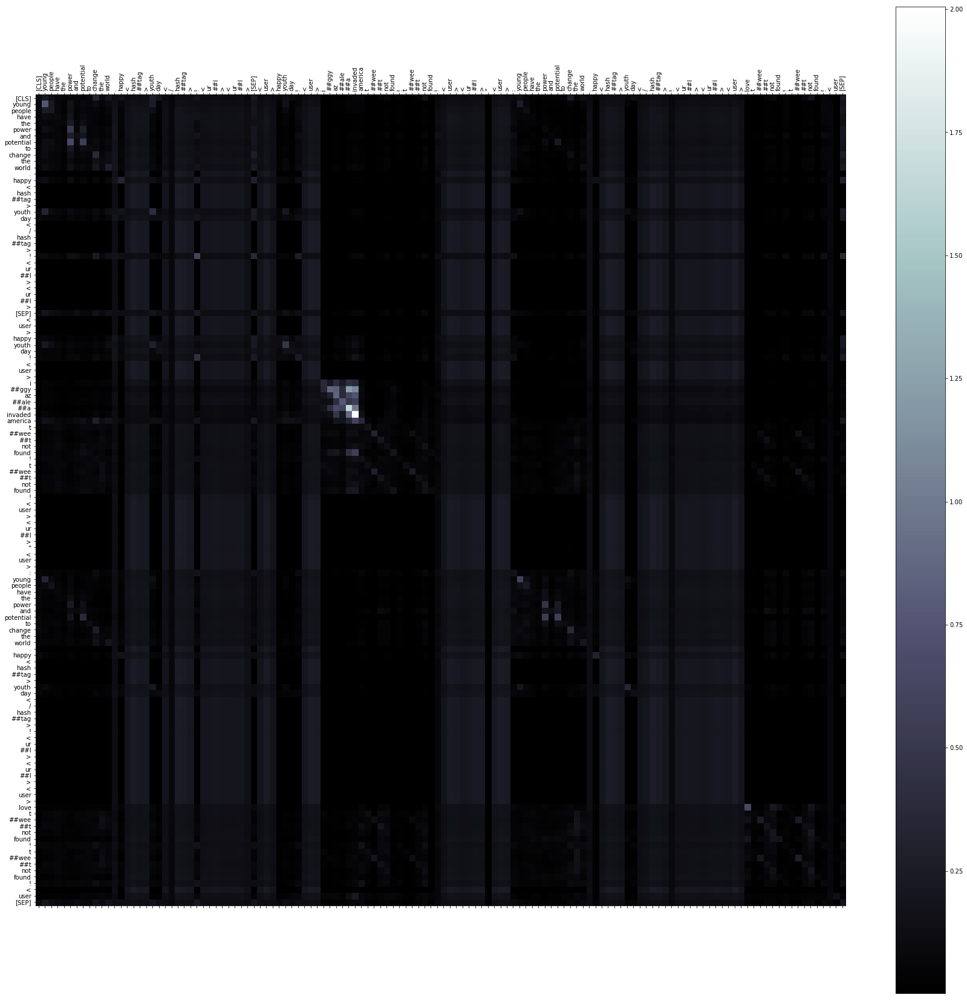

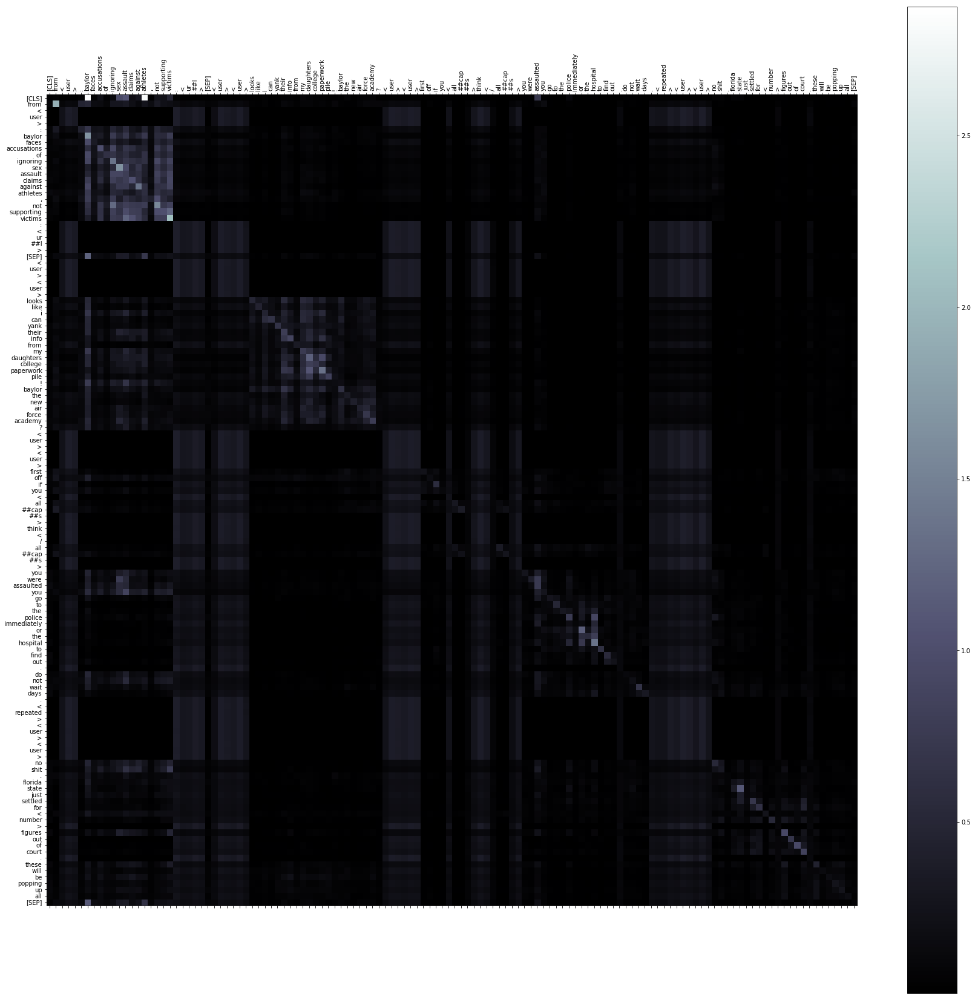

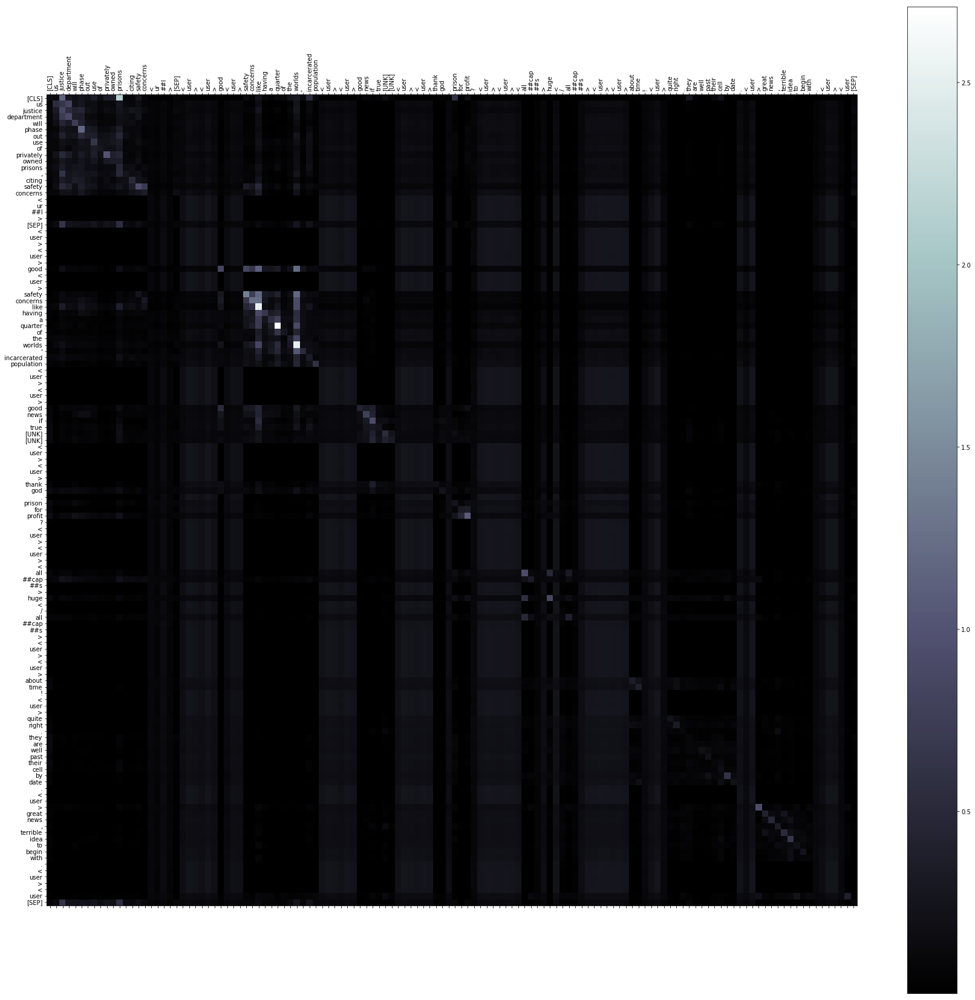

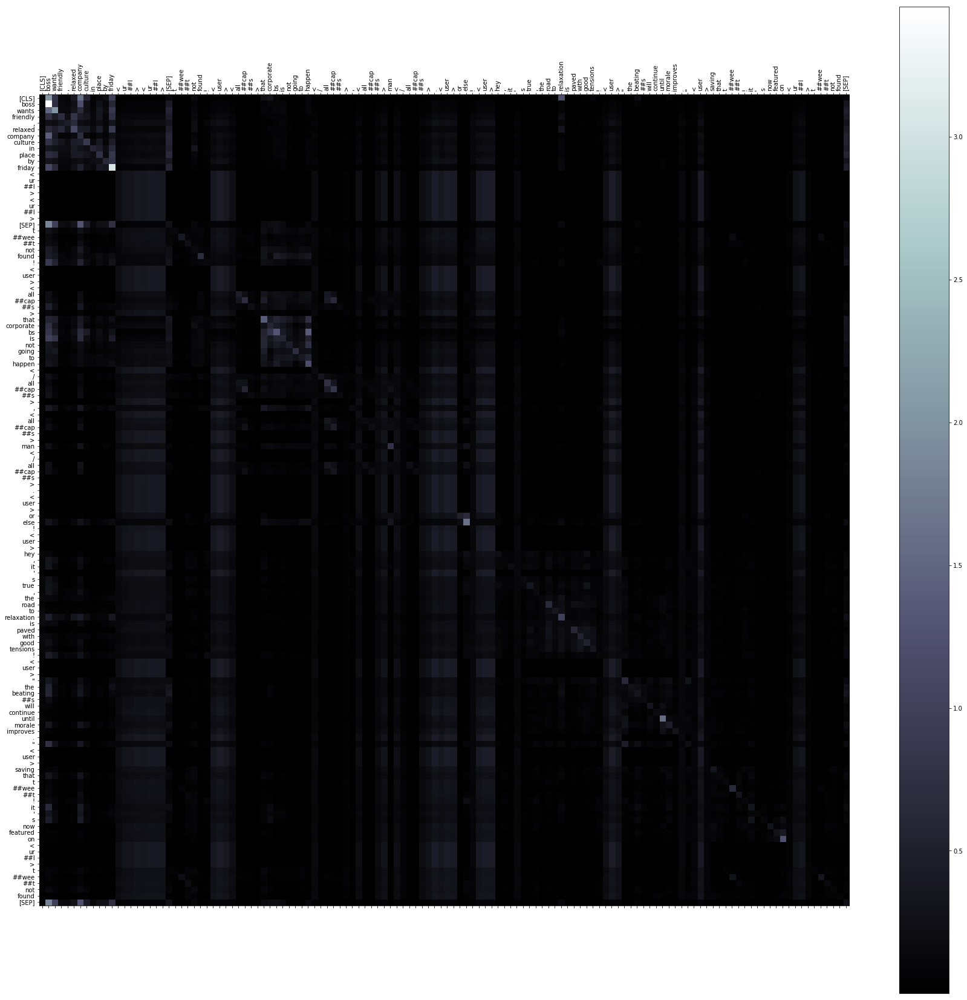

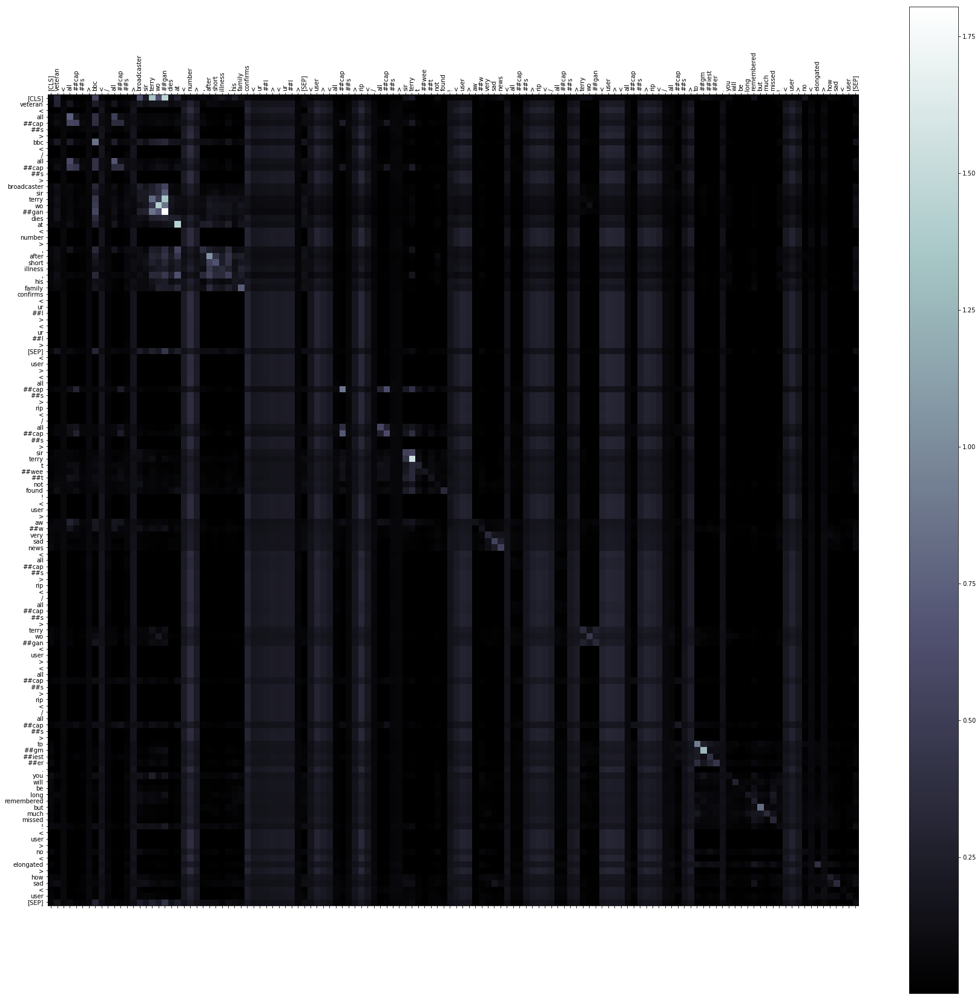

...

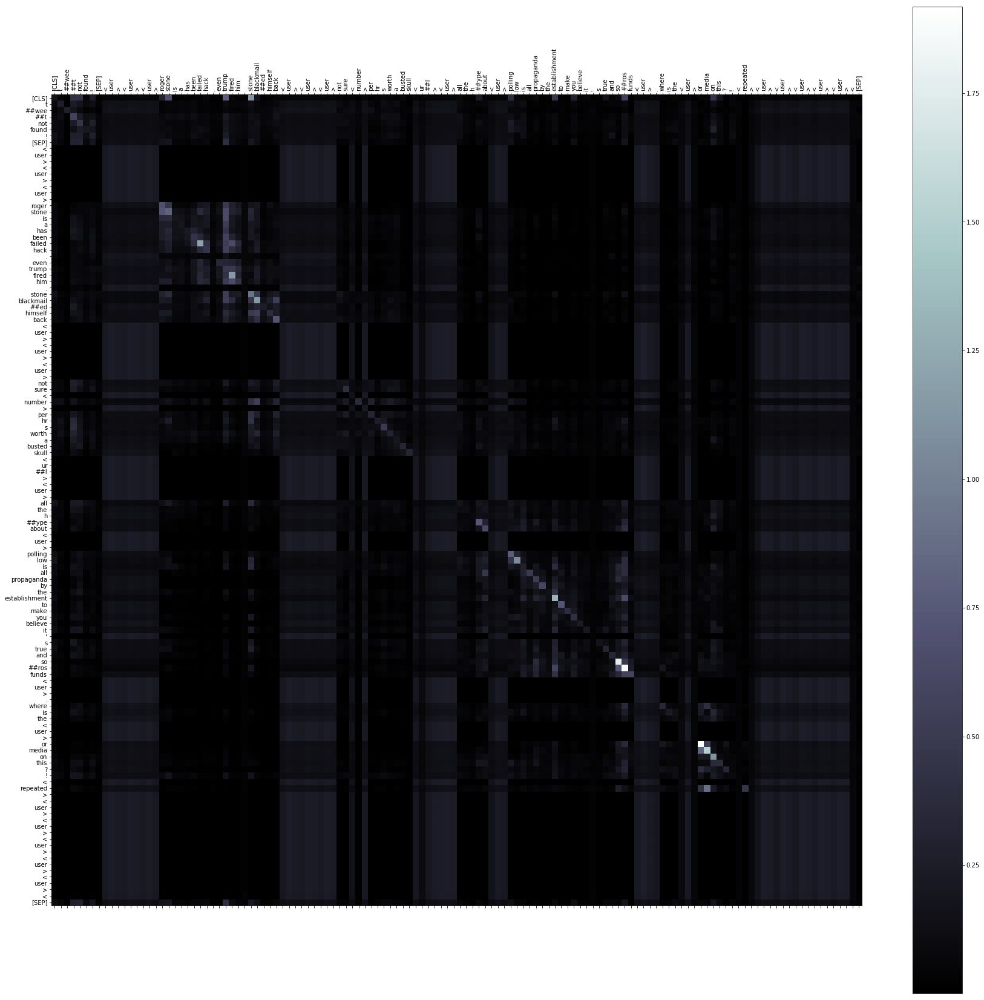

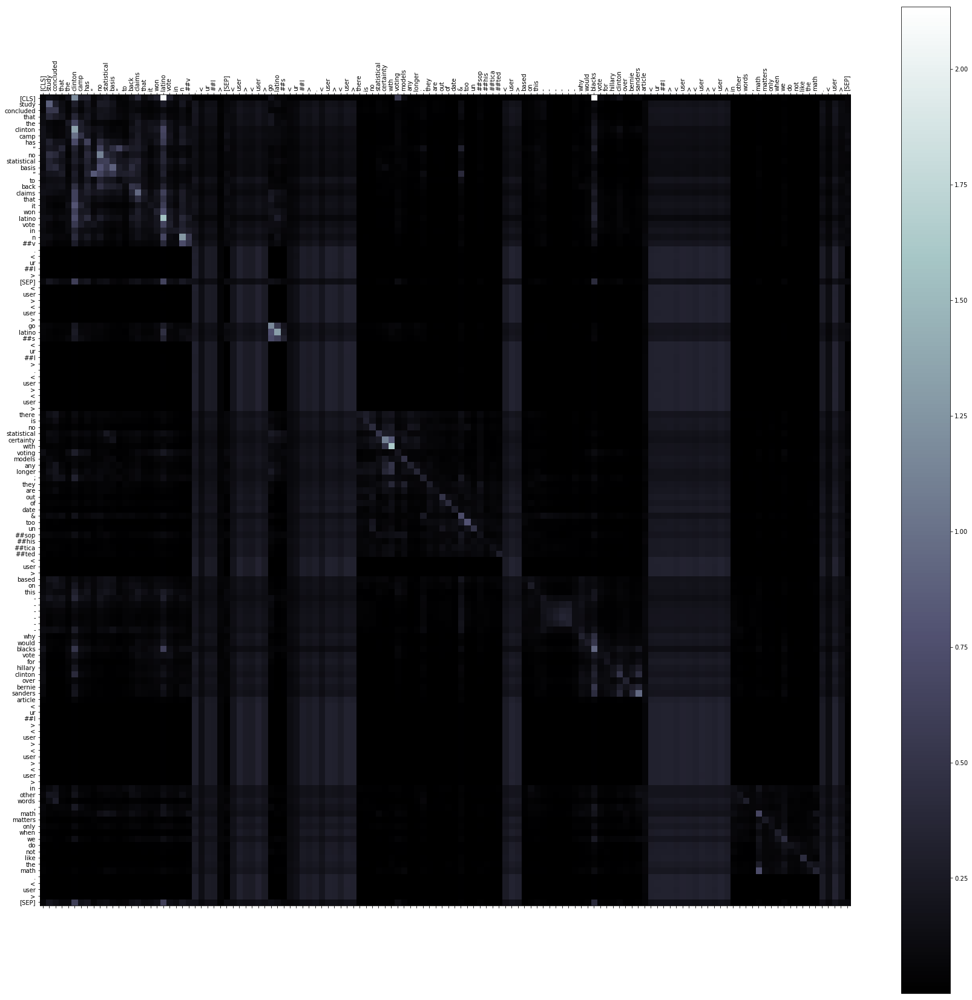

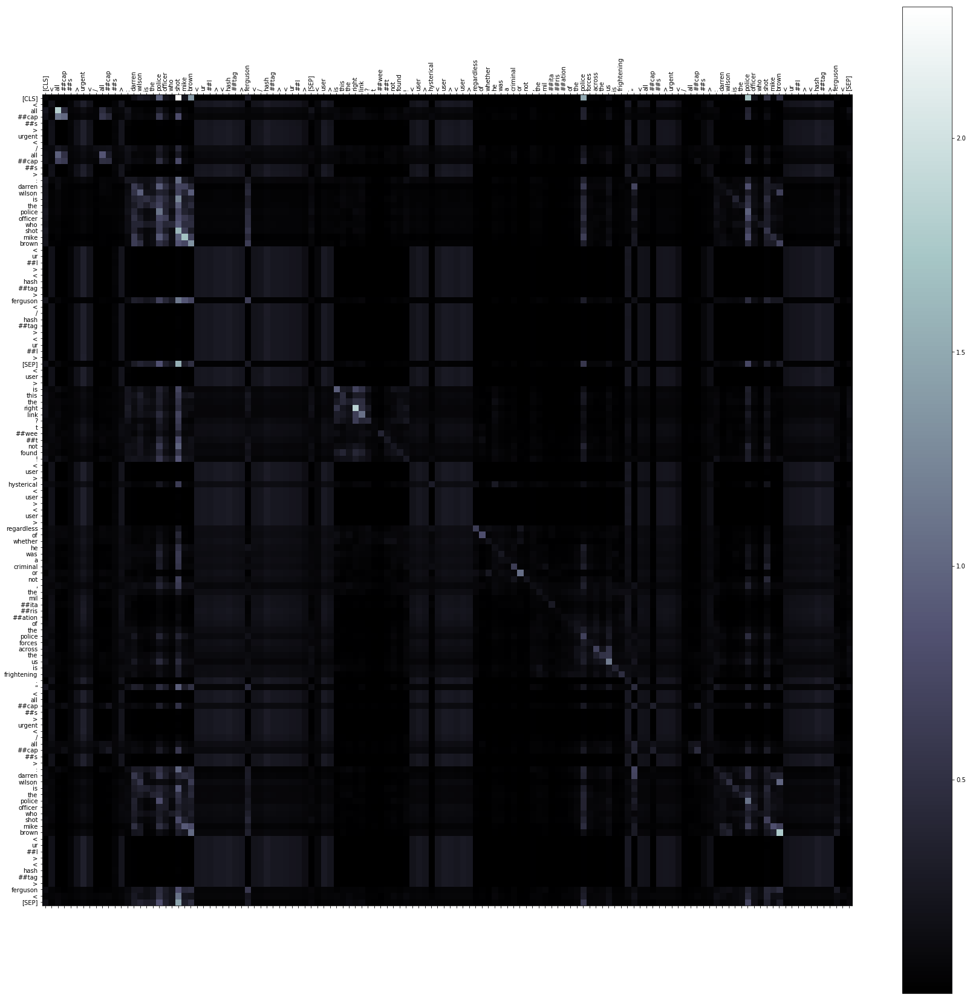

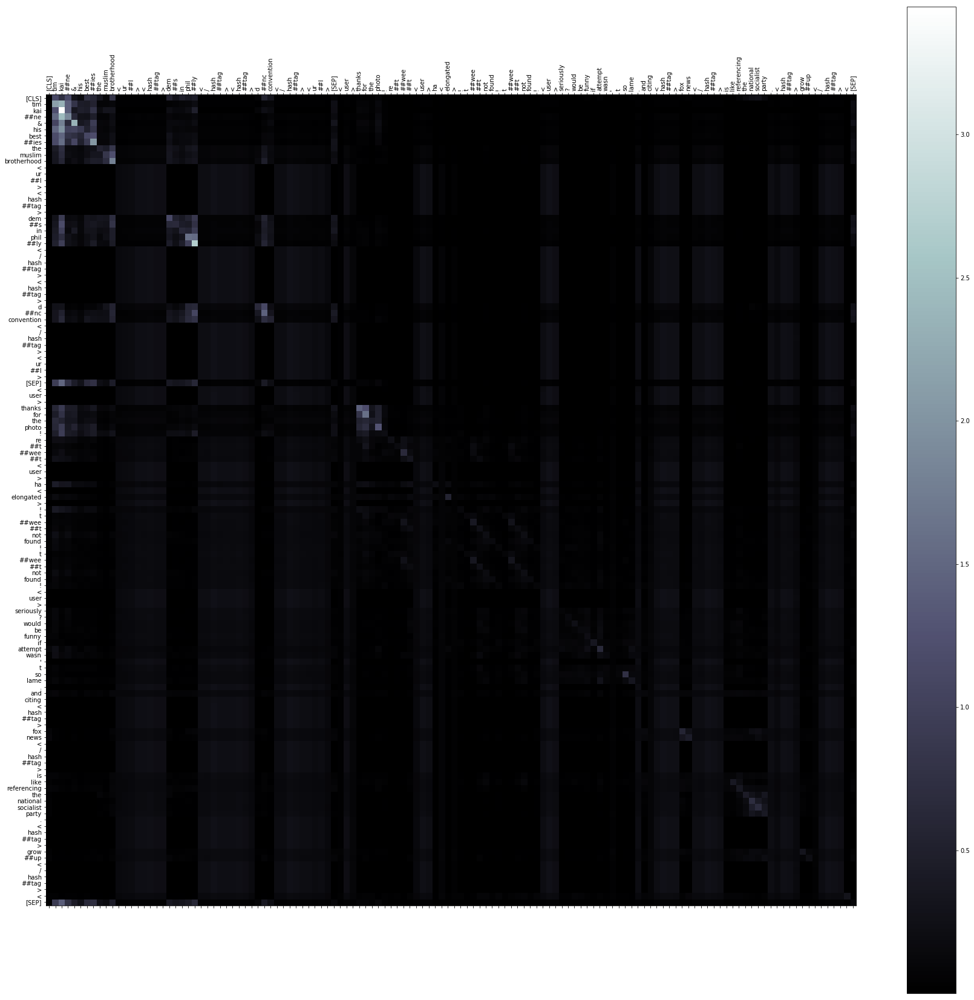

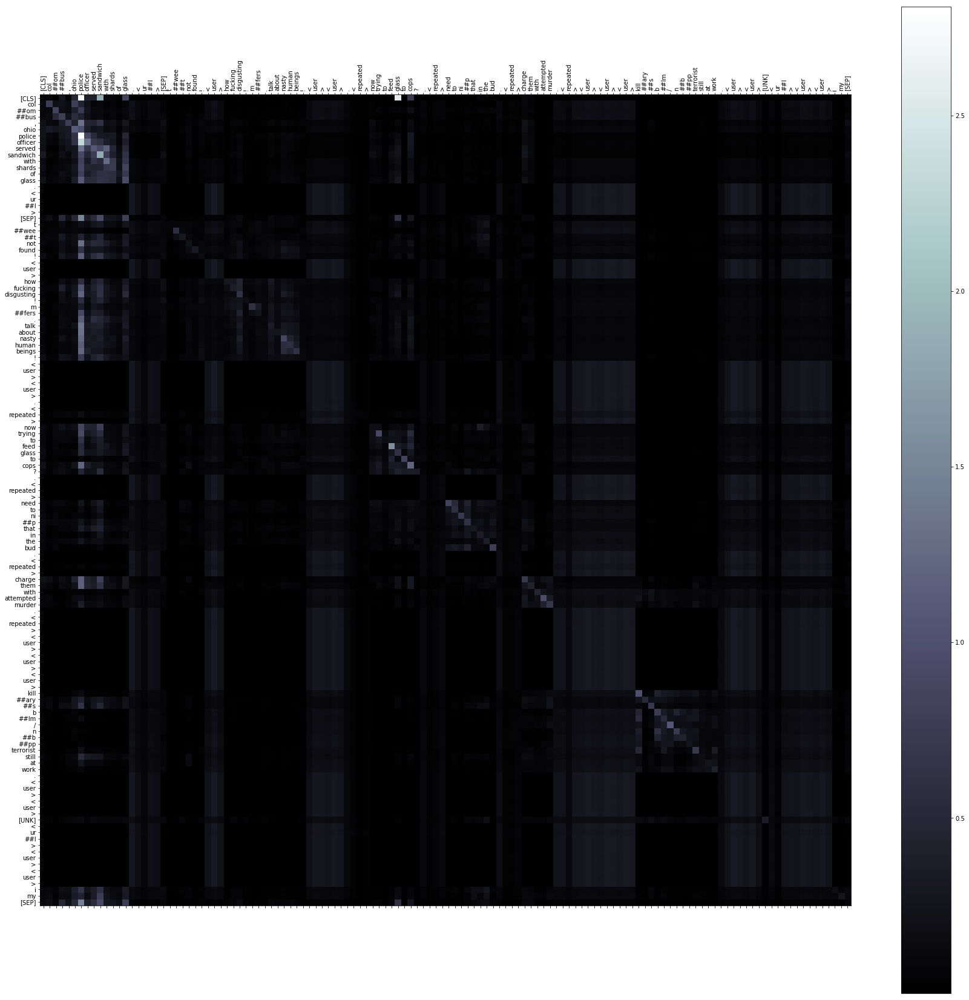

In [85]:
eval_examples = processor.get_dev_examples(data_dir)
eval_features = run_classifier.convert_examples_to_features(
    eval_examples, label_list, max_seq_length, tokenizer, output_mode)
print("***** Running evaluation *****")
print("  Num examples = %d", len(eval_examples))
print("  Batch size = %d", eval_batch_size)
all_input_ids = torch.tensor([f.input_ids for f in eval_features], dtype=torch.long)
all_input_mask = torch.tensor([f.input_mask for f in eval_features], dtype=torch.long)
all_segment_ids = torch.tensor([f.segment_ids for f in eval_features], dtype=torch.long)

if output_mode == "classification":
    all_label_ids = torch.tensor([f.label_id for f in eval_features], dtype=torch.long)
elif output_mode == "regression":
    all_label_ids = torch.tensor([f.label_id for f in eval_features], dtype=torch.float)

eval_data = TensorDataset(all_input_ids, all_input_mask, all_segment_ids, all_label_ids)
# Run prediction for full data
eval_sampler = SequentialSampler(eval_data)
eval_dataloader = DataLoader(eval_data, sampler=eval_sampler, batch_size=eval_batch_size)

model.eval()
eval_loss = 0
nb_eval_steps = 0
preds = []
eval_index = 1

for input_ids, input_mask, segment_ids, label_ids in tqdm(eval_dataloader, desc="Evaluating"):
    input_ids = input_ids.to(device)
    input_mask = input_mask.to(device)
    segment_ids = segment_ids.to(device)
    label_ids = label_ids.to(device)

    with torch.no_grad():
        logits, attention_probs = model(input_ids, segment_ids, input_mask, labels=None, return_attention=True)

    # create eval loss and other metric required by the task
    if output_mode == "classification":
        loss_fct = CrossEntropyLoss()
        tmp_eval_loss = loss_fct(logits.view(-1, num_labels), label_ids.view(-1))
    elif output_mode == "regression":
        loss_fct = MSELoss()
        tmp_eval_loss = loss_fct(logits.view(-1), label_ids.view(-1))

    eval_loss += tmp_eval_loss.mean().item()
    nb_eval_steps += 1
    if len(preds) == 0:
        preds.append(logits.detach().cpu().numpy())
    else:
        preds[0] = np.append(
            preds[0], logits.detach().cpu().numpy(), axis=0)
    
    # Process and save attention visualization
    output = torch.argmax(logits, dim=1)
    for i in range(len(label_ids)):
        showAttention(int(output[i]), int(label_ids[i]), input_ids[i].tolist(), attention_probs[i].cpu(), eval_index)
        eval_index += 1

eval_loss = eval_loss / nb_eval_steps
preds = preds[0]
if output_mode == "classification":
    preds = np.argmax(preds, axis=1)
elif output_mode == "regression":
    preds = np.squeeze(preds)
result = run_classifier.compute_metrics(task_name, preds, all_label_ids.numpy())
loss = tr_loss/nb_tr_steps if do_train else None

result['eval_loss'] = eval_loss
result['loss'] = loss

# output_eval_file = os.path.join(args.output_dir, "eval_results.txt")
# with open(output_eval_file, "w") as writer:
#     logger.info("***** Eval results *****")
#     for key in sorted(result.keys()):
#         logger.info("  %s = %s", key, str(result[key]))
#         writer.write("%s = %s\n" % (key, str(result[key])))

In [21]:
attention_probs.shape   # torch.Size([8, 12, 128, 128])
# 8 is batch size, 12 is number of attention heads

torch.Size([8, 12, 128, 128])